<h1><center>Introduction</center></h1>

<h2> Acknowledgements </h2>
The data were publically accessible through the UCLA Energy Atlas website. It has been uploaded here for easy access through the Kaggle API for use in notebook driven analysis later on. Last access: March 4, 2022.

Note: The website and data are continually updated. There is no guarantee that the data on the website at any given moment will be identical to the data saved in this Kaggle repository.

Citation: Pincetl, S., Gustafson, H., Strug, L., Cheng, D. (2019). ​​UCLA Energy Atlas (version 2.0). California Center for Sustainable Communities. UCLA. Los Angeles, CA. http://energyatlas.ucla.edu

This dataset contains annual energy consumption data for the Los Angeles region for the year of 2016. The data contains both electricity consumption as well as natural gas consumption. The data are aggregated by building type (bld), residential income (income), building vintage (vintage), and building size (sqft).

<h5><a href="kaggle.com/datasets/josephko/la-energy-atlas-2016">Kaggle Dataset</a></h5>

# Import

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns

import os

# Data

In [2]:
data_dir = '.\data'

In [3]:
raw_data = os.listdir(data_dir)
raw_data

['column_names_dictionary.csv',
 'geos.csv',
 'income_quintile_2006_2010.csv',
 'income_quintile_2011_2016.csv',
 'sqft_id_ranges.csv',
 'usage_bld_btu.csv',
 'usage_bld_ghg.csv',
 'usage_bld_kwh.csv',
 'usage_bld_therms.csv',
 'usage_income_btu.csv',
 'usage_income_ghg.csv',
 'usage_income_kwh.csv',
 'usage_income_therms.csv',
 'usage_sqft_btu.csv',
 'usage_sqft_ghg.csv',
 'usage_sqft_kwh.csv',
 'usage_sqft_therms.csv',
 'usage_vintage_btu.csv',
 'usage_vintage_ghg.csv',
 'usage_vintage_kwh.csv',
 'usage_vintage_therms.csv',
 'vintage_id_ranges.csv']

In [4]:
data_column = []
for data in raw_data:
    data_column.append(f'.\data\{data}')

print(data_column)

['.\\data\\column_names_dictionary.csv', '.\\data\\geos.csv', '.\\data\\income_quintile_2006_2010.csv', '.\\data\\income_quintile_2011_2016.csv', '.\\data\\sqft_id_ranges.csv', '.\\data\\usage_bld_btu.csv', '.\\data\\usage_bld_ghg.csv', '.\\data\\usage_bld_kwh.csv', '.\\data\\usage_bld_therms.csv', '.\\data\\usage_income_btu.csv', '.\\data\\usage_income_ghg.csv', '.\\data\\usage_income_kwh.csv', '.\\data\\usage_income_therms.csv', '.\\data\\usage_sqft_btu.csv', '.\\data\\usage_sqft_ghg.csv', '.\\data\\usage_sqft_kwh.csv', '.\\data\\usage_sqft_therms.csv', '.\\data\\usage_vintage_btu.csv', '.\\data\\usage_vintage_ghg.csv', '.\\data\\usage_vintage_kwh.csv', '.\\data\\usage_vintage_therms.csv', '.\\data\\vintage_id_ranges.csv']


In [5]:
pd.set_option('display.max_columns', None)  # or 1000
pd.set_option('display.max_rows', None)  # or 1000
pd.set_option('display.max_colwidth', -1)  # or 199

C:\Users\AUTOME~1\AppData\Local\Temp/ipykernel_5956/1999909185.py:3: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('display.max_colwidth', -1)  # or 199


In [6]:
df_column = pd.read_csv(data_column[0])
pd.DataFrame({'description': df_column.description}, index = [0])
df_column

,column name,description
0,count,total count of parcels
1,enviroscren_tracts,number of disadvantaged CalEnviroScreen census tracts
2,geog_id,unique ID for geographies
3,id,unique ID for geographies
4,income_quintile,quintile number
5,income_range,each income quintile corresponds to a specific income range
6,med_income,median household income
7,name,official geography name
8,net_solar_pot,net solar potential in kilowatt-hours (solar potential minus consumption) (2010 only)
9,pct_elec,percentage of consumption accounted for by electricity


In [7]:
df_geos = pd.read_csv(data_column[1])
df_geos

,geo_id,name,pop,pop_sqmi,med_income,pct_own,pct_rent,year,enviroscreen_tracts,sqmi,solar_pot,net_solar_pot,count
0,cogs_5,Westside Cities COG,785154,3929.845670,78816.75,0.051352,0.622423,2010,16.0,199.792579,2.993137e+09,-8888,218333.0
1,cities_39,la habra heights,6310,702.993351,111373.50,0.934310,0.065690,2010,0.0,8.975903,2.343956e+07,-8888,2247.0
2,cities_40,hawaiian gardens,14076,10142.296070,67831.00,0.450913,0.549087,2010,1.0,1.387851,4.271364e+07,-8888,2569.0
3,cities_41,hawthorne,86783,9801.098133,48678.25,0.272886,0.727080,2010,15.0,8.854416,3.889526e+08,-8888,12879.0
4,cities_42,palmdale,148945,947.283953,59654.75,0.675369,0.324607,2010,0.0,157.233741,1.077350e+09,-8888,48080.0
5,cities_43,palos verdes estates,13532,1952.769605,147039.00,0.886800,0.113788,2010,0.0,6.929645,5.309578e+07,-8888,5479.0
6,cities_44,paramount,54335,7746.049753,40845.50,0.434107,0.566324,2010,10.0,7.014543,2.719671e+08,-8888,8773.0
7,cities_46,pico rivera,64487,4964.575515,59577.25,0.692639,0.307302,2010,10.0,12.989429,3.676016e+08,-8888,14924.0
8,cities_47,pomona,147887,4407.418777,58554.25,0.551886,0.447956,2010,23.0,33.554107,8.430683e+08,-8888,32991.0
9,cities_48,rancho palos verdes,41134,2104.197330,121976.75,0.795704,0.204166,2010,0.0,19.548547,2.361104e+08,-8888,15593.0


In [8]:
df_geos.shape

(962, 13)

In [9]:
df_income_2006_2010 = pd.read_csv(data_column[2])
df_income_2006_2010

,quintile,income range
0,1,"< $36,474"
1,2,"$36,474-$49,375"
2,3,"$49,375-$64,375"
3,4,"$64,375-$86,622"
4,5,"> $86,622"


In [10]:
df_income_2011_2016 = pd.read_csv(data_column[3])
df_income_2011_2016

,quintile,income range
0,1,"< $41,685"
1,2,"$41,685-$56,290"
2,3,"$56,290-$74,167"
3,4,"$74,167-$99,028"
4,5,"> $99,028"


In [11]:
read_data = []
for i in data_column:
    read_data.append(pd.read_csv(i))
    
read_data[19]

,geo_id,sqft,usage,usage_med,usage_med_sqft,usetype,vintage_id,year,name
0,cities_1,NaN,NaN,NaN,NaN,agriculture,1,2016,agoura hills
1,cities_1,NaN,NaN,NaN,NaN,agriculture,2,2016,agoura hills
2,cities_1,NaN,NaN,NaN,NaN,agriculture,3,2016,agoura hills
3,cities_1,NaN,NaN,NaN,NaN,agriculture,4,2016,agoura hills
4,cities_1,4.535100e+04,masked,masked,masked,commercial,1,2016,agoura hills
5,cities_1,1.207390e+05,masked,masked,masked,commercial,2,2016,agoura hills
6,cities_1,3.167956e+06,32751487.0000,139892.0000,9.7676,commercial,3,2016,agoura hills
7,cities_1,1.230324e+06,masked,masked,masked,commercial,4,2016,agoura hills
8,cities_1,NaN,masked,masked,masked,condo,1,2016,agoura hills
9,cities_1,2.465973e+06,15469641.0000,7642.0000,4.4422,condo,2,2016,agoura hills


In [12]:
read_data[4]

,sqft_id,built square footage range
0,1,0
1,2,0-10k
2,3,10k-20k
3,4,20k-30k
4,5,30k-40k
5,6,40k-50k
6,7,>50k


In [13]:
read_data[5]

,geo_id,sqft,usage,usage_med,usage_med_sqft,usetype,year,pct_elec,pct_ng,name,pop,usage_percap
0,cities_1,1.253000e+03,masked,masked,masked,agriculture,2016,masked,masked,agoura hills,NaN,masked
1,cities_1,4.820002e+06,307943899305.5130,552251718.742479,46351.2600,commercial,2016,0.729374077813779,0.27062592218622,agoura hills,NaN,NaN
2,cities_1,8.916603e+06,371532651324.6650,75308184.502491,34141.0256,condo,2016,0.401411831210031,0.598588168789969,agoura hills,NaN,NaN
3,cities_1,7.358160e+05,masked,masked,masked,industrial,2016,masked,masked,agoura hills,NaN,masked
4,cities_1,1.001920e+05,masked,masked,masked,institutional,2016,masked,masked,agoura hills,NaN,masked
5,cities_1,7.424200e+05,13880934410.2757,551195246.006691,27645.8101,multi_family,2016,0.494247031872507,0.505752968127493,agoura hills,NaN,NaN
6,cities_1,4.199000e+03,masked,masked,masked,other,2016,masked,masked,agoura hills,NaN,masked
7,cities_1,5.202700e+04,masked,masked,masked,residential_other,2016,masked,masked,agoura hills,NaN,masked
8,cities_1,0.000000e+00,masked,masked,masked,residential_uncat,2016,masked,masked,agoura hills,NaN,masked
9,cities_1,1.458283e+07,607423395220.2180,77423013.203888,34664.6960,res_total,2016,0.39367841860114,0.606321581398859,agoura hills,20236.0,30016969.5207


In [14]:
df_kwh = read_data[18]
df_kwh.shape

(46176, 11)

In [15]:
df_vintage = read_data[19]
df_vintage.shape

(23088, 9)

In [16]:
df_vintage_range = read_data[20]
df_vintage_range.shape

(23088, 9)

# Explore Data

In [17]:
df_geos.dtypes

geo_id                 object 
name                   object 
pop                    int64  
pop_sqmi               float64
med_income             float64
pct_own                float64
pct_rent               float64
year                   int64  
enviroscreen_tracts    float64
sqmi                   float64
solar_pot              float64
net_solar_pot          int64  
count                  float64
dtype: object

In [18]:
df_geos.isna().sum()

geo_id                 0 
name                   0 
pop                    0 
pop_sqmi               0 
med_income             0 
pct_own                0 
pct_rent               0 
year                   0 
enviroscreen_tracts    6 
sqmi                   0 
solar_pot              96
net_solar_pot          0 
count                  6 
dtype: int64

In [19]:
df_geos.duplicated().any()

False

In [20]:
df_geos.describe()

,pop,pop_sqmi,med_income,pct_own,pct_rent,year,enviroscreen_tracts,sqmi,solar_pot,net_solar_pot,count
count,9.620000e+02,962.000000,962.00000,962.000000,962.000000,962.00000,956.000000,962.000000,8.660000e+02,962.000000,9.560000e+02
mean,9.521074e+04,3630.544744,60476.95868,-912.709482,-912.990815,2012.00000,9.334728,251.040841,2.105033e+08,-8288.614345,3.612782e+03
std,5.297638e+05,5904.753216,36313.42010,2505.575749,2505.470096,2.00104,56.090175,2053.444268,1.805029e+09,554.051801,8.716054e+04
min,-7.777000e+03,-7777.000000,-7777.00000,-7777.000000,-7777.000000,2010.00000,0.000000,0.379224,-7.777000e+03,-8888.000000,-9.999000e+03
25%,8.272500e+03,795.577315,43005.87500,0.357025,0.231950,2010.00000,0.000000,3.940814,-7.777000e+03,-8888.000000,-7.777000e+03
50%,2.574650e+04,3536.670995,61042.75000,0.561293,0.405469,2012.00000,1.000000,9.517527,-7.777000e+03,-7777.000000,-7.777000e+03
75%,5.840300e+04,7081.864434,79827.12500,0.723051,0.561796,2014.00000,5.000000,22.909640,9.188965e+07,-7777.000000,3.883250e+03
max,9.974203e+06,31503.336480,203318.00000,76.306455,38.982639,2014.00000,1020.000000,29920.509480,4.714327e+10,-7777.000000,2.392100e+06


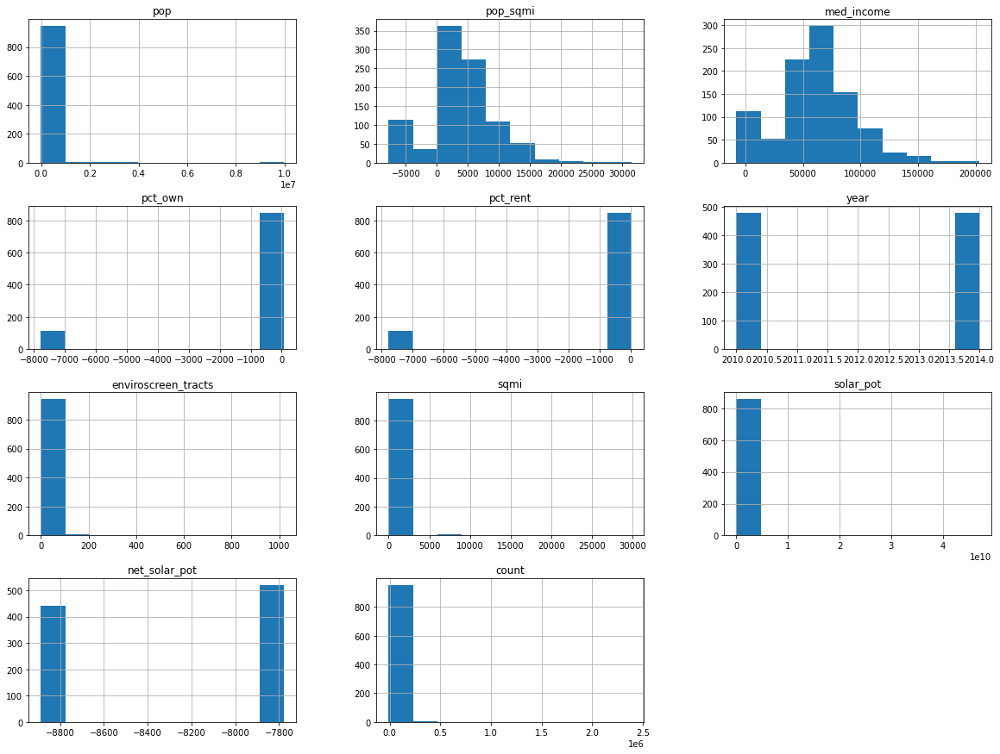

In [21]:
df_geos.hist(bins=10, figsize=(20,15))
plt.show()

## Checking Min and Max Year

In [22]:
min_year = df_geos.year.min()
print(f"The lowest year in the dataset is {min_year}")
max_year = df_geos.year.max()
print(f"The newest year in the dataset is {max_year}")

The lowest year in the dataset is 2010
The newest year in the dataset is 2014


In [23]:
df_geos.year.unique()

array([2010, 2014], dtype=int64)

In [24]:
year_2010 = df_geos[df_geos['year']==2010]
year_2010

,geo_id,name,pop,pop_sqmi,med_income,pct_own,pct_rent,year,enviroscreen_tracts,sqmi,solar_pot,net_solar_pot,count
0,cogs_5,Westside Cities COG,785154,3929.845670,78816.75,0.051352,0.622423,2010,16.0,199.792579,2.993137e+09,-8888,218333.0
1,cities_39,la habra heights,6310,702.993351,111373.50,0.934310,0.065690,2010,0.0,8.975903,2.343956e+07,-8888,2247.0
2,cities_40,hawaiian gardens,14076,10142.296070,67831.00,0.450913,0.549087,2010,1.0,1.387851,4.271364e+07,-8888,2569.0
3,cities_41,hawthorne,86783,9801.098133,48678.25,0.272886,0.727080,2010,15.0,8.854416,3.889526e+08,-8888,12879.0
4,cities_42,palmdale,148945,947.283953,59654.75,0.675369,0.324607,2010,0.0,157.233741,1.077350e+09,-8888,48080.0
5,cities_43,palos verdes estates,13532,1952.769605,147039.00,0.886800,0.113788,2010,0.0,6.929645,5.309578e+07,-8888,5479.0
6,cities_44,paramount,54335,7746.049753,40845.50,0.434107,0.566324,2010,10.0,7.014543,2.719671e+08,-8888,8773.0
7,cities_46,pico rivera,64487,4964.575515,59577.25,0.692639,0.307302,2010,10.0,12.989429,3.676016e+08,-8888,14924.0
8,cities_47,pomona,147887,4407.418777,58554.25,0.551886,0.447956,2010,23.0,33.554107,8.430683e+08,-8888,32991.0
9,cities_48,rancho palos verdes,41134,2104.197330,121976.75,0.795704,0.204166,2010,0.0,19.548547,2.361104e+08,-8888,15593.0


In [25]:
df_geos_pop = year_2010.sort_values("pop", ascending=False)
df_geos_pop

,geo_id,name,pop,pop_sqmi,med_income,pct_own,pct_rent,year,enviroscreen_tracts,sqmi,solar_pot,net_solar_pot,count
40,counties_19,Los Angeles County,9818605,1636.323879,56250.00,0.476597,0.523403,2010,1020.0,6000.404397,4.714327e+10,-8888,2392100.0
27,cities_68,los angeles,3785479,5471.052245,53577.00,0.381775,0.618217,2010,536.0,691.910592,1.375362e+10,-8888,793881.0
257,cogs_2,Gateway Cities COG,2047709,3689.062446,53857.75,0.056682,0.503582,2010,299.0,555.075722,1.234912e+10,-8888,439747.0
440,cogs_4,San Fernando Valley COG,2010738,2351.315089,77975.00,0.040941,0.480550,2010,163.0,855.154637,9.399859e+09,-8888,505099.0
439,cogs_6,San Gabriel Valley COG,1812153,3379.399438,69509.50,0.064529,0.399077,2010,130.0,536.235220,9.788050e+09,-8888,469279.0
256,cogs_1,South Bay Cities COG,1053354,5003.919537,56169.25,0.030995,0.494208,2010,109.0,210.505783,5.968556e+09,-8888,262777.0
431,cities_343,los angeles unincorporated area,1046448,398.754290,57823.00,62.273751,37.726249,2010,NaN,2624.292772,4.724530e+09,-8888,NaN
0,cogs_5,Westside Cities COG,785154,3929.845670,78816.75,0.051352,0.622423,2010,16.0,199.792579,2.993137e+09,-8888,218333.0
150,neighborhoods_199,long beach,463166,6122.956264,58419.00,0.737796,0.582290,2010,55.0,75.644179,1.559258e+09,-8888,106726.0
26,cities_67,long beach,462149,6160.480863,58906.00,0.416569,0.583401,2010,57.0,75.018332,1.554372e+09,-8888,105920.0


## Visualize Categorical Data : Geo_Id

In [26]:
# to change value of nan value with another value
df_geos_pop = df_geos_pop.fillna(method='ffill')

In [27]:
# Split geo_id, to get geo and id
stack= df_geos_pop.geo_id.str.split(r"_", expand=True).stack()
print(f"We now have a single column with shape : {stack.shape}")
num_geo = stack.value_counts()
print(f"Number of list {len(num_geo)}")
# df_geos.head()

We now have a single column with shape : (962,)
Number of list 341


In [28]:
fig_pie = px.pie(labels=num_geo.index[:4], values=num_geo.values[:4], title="Geo Orientation",
                hover_name=num_geo.index[:4], names=num_geo.index[:4], hole=0.4)
fig_pie.show()

### Which city has the most population in 2010

In [29]:
# split data into new columns 
df_geos_pop[["geo","id"]]=df_geos_pop.geo_id.str.split('_', expand=True)

In [30]:
cities = df_geos_pop[df_geos_pop["geo"]=="cities"][:15]
cities_bar = px.bar(cities,y=["pop"],x="name",)
cities_bar.show()

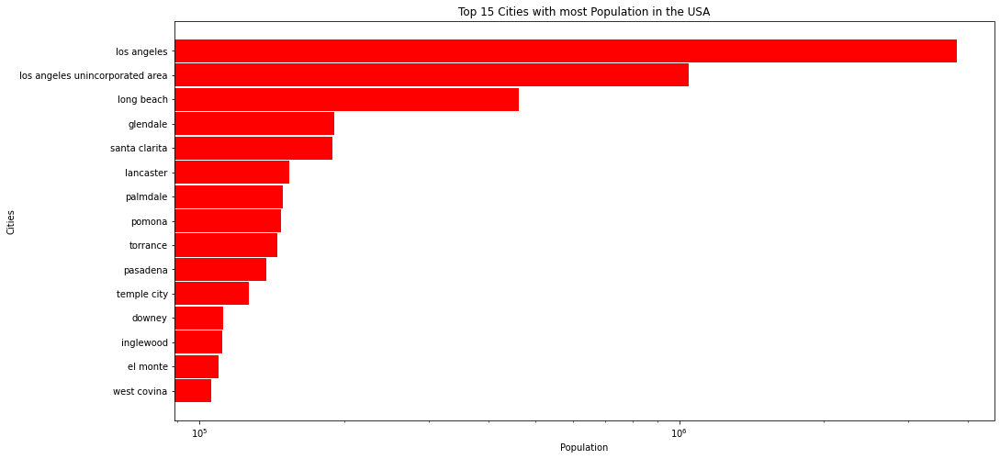

In [31]:
# using matplotlib
fig = plt.figure(figsize=(16,8))
cities = cities.sort_values('pop', ascending=True)
cities_bat_plt = plt.barh(cities['name'],cities["pop"], align="center", log=True,color='r', height=0.95)
plt.title("Top 15 Cities with most Population in the USA")
plt.xlabel("Population")
plt.ylabel("Cities")
plt.show()

In [32]:
df_column

,column name,description
0,count,total count of parcels
1,enviroscren_tracts,number of disadvantaged CalEnviroScreen census tracts
2,geog_id,unique ID for geographies
3,id,unique ID for geographies
4,income_quintile,quintile number
5,income_range,each income quintile corresponds to a specific income range
6,med_income,median household income
7,name,official geography name
8,net_solar_pot,net solar potential in kilowatt-hours (solar potential minus consumption) (2010 only)
9,pct_elec,percentage of consumption accounted for by electricity


## Percentage People who has House and who has rent 

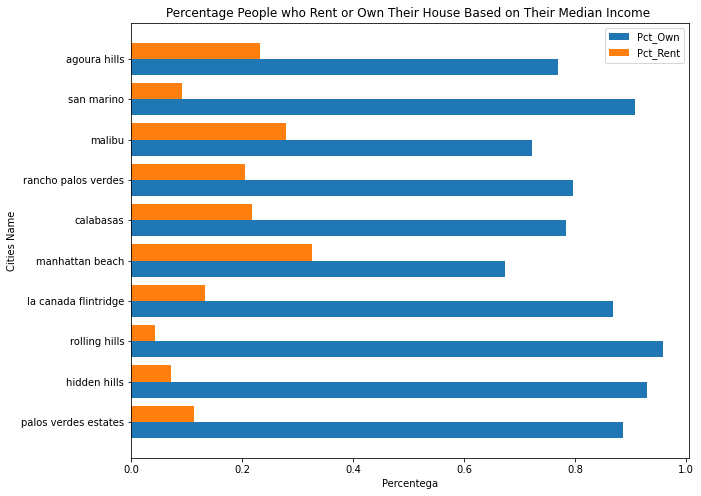

In [33]:
df_pct_own_rent = df_geos_pop.where((df_geos_pop.year==2010) & (df_geos_pop.geo=="cities"))
df_pct_own_rent=df_pct_own_rent.dropna()
df_pct_own_rent=df_pct_own_rent.sort_values("med_income", ascending=False)[:10]

plt.figure(figsize=(10,8))
y_axis = np.arange(len(df_pct_own_rent.name))

# Multiple Bar
plt.barh(y_axis -0.2, df_pct_own_rent.pct_own, label="Pct_Own", height=0.4)
plt.barh(y_axis +0.2, df_pct_own_rent.pct_rent, label="Pct_Rent", height=0.4)

plt.yticks(y_axis, df_pct_own_rent.name)
plt.title("Percentage People who Rent or Own Their House Based on Their Median Income ")
plt.ylabel("Cities Name")
plt.xlabel("Percentega")
plt.legend()


plt.show()
# df_pct_own_rent

In [34]:
df_pct_own_rent

,geo_id,name,pop,pop_sqmi,med_income,pct_own,pct_rent,year,enviroscreen_tracts,sqmi,solar_pot,net_solar_pot,count,geo,id
5,cities_43,palos verdes estates,13532.0,1952.769605,147039.00,0.886800,0.113788,2010.0,0.0,6.929645,53095777.5,-8888.0,5479.0,cities,43
12,cities_52,hidden hills,1856.0,751.050921,143929.00,0.928721,0.071279,2010.0,0.0,2.471204,8315317.5,-8888.0,780.0,cities,52
10,cities_50,rolling hills,1930.0,444.851825,137370.00,0.957971,0.043478,2010.0,0.0,4.338523,9037222.5,-8888.0,785.0,cities,50
319,cities_38,la canada flintridge,20815.0,1642.214825,127401.50,0.867755,0.131964,2010.0,0.0,12.674956,91559010.0,-8888.0,-9999.0,cities,38
262,cities_71,manhattan beach,34805.0,6095.690063,126516.25,0.674258,0.325742,2010.0,0.0,5.709772,163411466.3,-8888.0,-9999.0,cities,71
948,cities_28,calabasas,23058.0,1145.160125,126372.50,0.783396,0.216738,2010.0,0.0,20.135175,111850575.0,-8888.0,8780.0,cities,28
9,cities_48,rancho palos verdes,41134.0,2104.197330,121976.75,0.795704,0.204166,2010.0,0.0,19.548547,236110428.8,-8888.0,15593.0,cities,48
29,cities_70,malibu,12645.0,439.887854,115662.00,0.721509,0.279004,2010.0,0.0,28.745963,94191840.0,-8888.0,7028.0,cities,70
21,cities_61,san marino,13249.0,2404.453514,115060.00,0.908510,0.091718,2010.0,0.0,5.510192,34109452.5,-8888.0,4759.0,cities,61
919,cities_1,agoura hills,19973.0,1745.223918,114998.00,0.768529,0.231886,2010.0,0.0,11.444377,98426047.5,-8888.0,7823.0,cities,1


## Creating Categorical Income

In [35]:
df_income = df_geos_pop[df_geos_pop["med_income"]>0]
df_income.head()

,geo_id,name,pop,pop_sqmi,med_income,pct_own,pct_rent,year,enviroscreen_tracts,sqmi,solar_pot,net_solar_pot,count,geo,id
40,counties_19,Los Angeles County,9818605,1636.323879,56250.00,0.476597,0.523403,2010,1020.0,6000.404397,4.714327e+10,-8888,2392100.0,counties,19
27,cities_68,los angeles,3785479,5471.052245,53577.00,0.381775,0.618217,2010,536.0,691.910592,1.375362e+10,-8888,793881.0,cities,68
257,cogs_2,Gateway Cities COG,2047709,3689.062446,53857.75,0.056682,0.503582,2010,299.0,555.075722,1.234912e+10,-8888,439747.0,cogs,2
440,cogs_4,San Fernando Valley COG,2010738,2351.315089,77975.00,0.040941,0.480550,2010,163.0,855.154637,9.399859e+09,-8888,505099.0,cogs,4
439,cogs_6,San Gabriel Valley COG,1812153,3379.399438,69509.50,0.064529,0.399077,2010,130.0,536.235220,9.788050e+09,-8888,469279.0,cogs,6


In [36]:
df_income_2006_2010

,quintile,income range
0,1,"< $36,474"
1,2,"$36,474-$49,375"
2,3,"$49,375-$64,375"
3,4,"$64,375-$86,622"
4,5,"> $86,622"


In [37]:
cat_income = []
for income in df_income.med_income:
    if income < 36474:
        cat_income.append("Layer 1 Income")
    elif income < 49375:
        cat_income.append("Layer 2 Income")
    elif income < 64375:
        cat_income.append('Layer 3 Income')
    elif income < 86622:
        cat_income.append('Layer 4 Income')
    else:
        cat_income.append("Layer 5 Income")

In [38]:
df_income["cat_income"] = cat_income
df_income.head()

C:\Users\AUTOME~1\AppData\Local\Temp/ipykernel_5956/1721470178.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,geo_id,name,pop,pop_sqmi,med_income,pct_own,pct_rent,year,enviroscreen_tracts,sqmi,solar_pot,net_solar_pot,count,geo,id,cat_income
40,counties_19,Los Angeles County,9818605,1636.323879,56250.00,0.476597,0.523403,2010,1020.0,6000.404397,4.714327e+10,-8888,2392100.0,counties,19,Layer 3 Income
27,cities_68,los angeles,3785479,5471.052245,53577.00,0.381775,0.618217,2010,536.0,691.910592,1.375362e+10,-8888,793881.0,cities,68,Layer 3 Income
257,cogs_2,Gateway Cities COG,2047709,3689.062446,53857.75,0.056682,0.503582,2010,299.0,555.075722,1.234912e+10,-8888,439747.0,cogs,2,Layer 3 Income
440,cogs_4,San Fernando Valley COG,2010738,2351.315089,77975.00,0.040941,0.480550,2010,163.0,855.154637,9.399859e+09,-8888,505099.0,cogs,4,Layer 4 Income
439,cogs_6,San Gabriel Valley COG,1812153,3379.399438,69509.50,0.064529,0.399077,2010,130.0,536.235220,9.788050e+09,-8888,469279.0,cogs,6,Layer 4 Income


In [39]:
df_income = df_income.groupby("cat_income").agg({"med_income":pd.Series.mean}).reset_index()

income_pie = px.pie(df_income, values="med_income", names="cat_income", title="Median Income", opacity=0.8,
                   hover_name="cat_income")
income_pie.show()

## Solar Potential

In [40]:
df_solar_pot = df_geos_pop[df_geos_pop["solar_pot"]>0]
df_solar_pot.head()

,geo_id,name,pop,pop_sqmi,med_income,pct_own,pct_rent,year,enviroscreen_tracts,sqmi,solar_pot,net_solar_pot,count,geo,id
40,counties_19,Los Angeles County,9818605,1636.323879,56250.00,0.476597,0.523403,2010,1020.0,6000.404397,4.714327e+10,-8888,2392100.0,counties,19
27,cities_68,los angeles,3785479,5471.052245,53577.00,0.381775,0.618217,2010,536.0,691.910592,1.375362e+10,-8888,793881.0,cities,68
257,cogs_2,Gateway Cities COG,2047709,3689.062446,53857.75,0.056682,0.503582,2010,299.0,555.075722,1.234912e+10,-8888,439747.0,cogs,2
440,cogs_4,San Fernando Valley COG,2010738,2351.315089,77975.00,0.040941,0.480550,2010,163.0,855.154637,9.399859e+09,-8888,505099.0,cogs,4
439,cogs_6,San Gabriel Valley COG,1812153,3379.399438,69509.50,0.064529,0.399077,2010,130.0,536.235220,9.788050e+09,-8888,469279.0,cogs,6


In [41]:
df_solar_pot =  df_solar_pot[df_solar_pot["geo"]=="cities"]


In [42]:
df_solar_pot["log_solar_pot"] = np.log(df_solar_pot["solar_pot"])
df_solar_pot = df_solar_pot.sort_values("log_solar_pot", ascending=False)[:10]
df_solar_pot.head(10)

,geo_id,name,pop,pop_sqmi,med_income,pct_own,pct_rent,year,enviroscreen_tracts,sqmi,solar_pot,net_solar_pot,count,geo,id,log_solar_pot
27,cities_68,los angeles,3785479,5471.052245,53577.00,0.381775,0.618217,2010,536.0,691.910592,1.375362e+10,-8888,793881.0,cities,68,23.344568
431,cities_343,los angeles unincorporated area,1046448,398.754290,57823.00,62.273751,37.726249,2010,109.0,2624.292772,4.724530e+09,-8888,262777.0,cities,343,22.276034
26,cities_67,long beach,462149,6160.480863,58906.00,0.416569,0.583401,2010,57.0,75.018332,1.554372e+09,-8888,105920.0,cities,67,21.164337
944,cities_23,lancaster,153488,1095.170961,58312.50,0.593492,0.406423,2010,1.0,140.149808,1.256530e+09,-8888,51537.0,cities,23,20.951620
322,cities_21,industry,219,12.464494,57377.50,0.000000,0.000000,2010,1.0,17.569908,1.219284e+09,-8888,1952.0,cities,21,20.921530
935,cities_10,carson,90803,3299.644402,66174.25,0.767463,0.232577,2010,12.0,27.519026,1.176332e+09,-8888,24003.0,cities,10,20.885667
22,cities_62,santa clarita,189378,1995.922762,90024.50,0.694049,0.306014,2010,0.0,94.882429,1.116165e+09,-8888,61618.0,cities,62,20.833165
4,cities_42,palmdale,148945,947.283953,59654.75,0.675369,0.324607,2010,0.0,157.233741,1.077350e+09,-8888,48080.0,cities,42,20.797770
261,cities_63,santa fe springs,19491,1507.779262,64334.25,0.615792,0.384756,2010,3.0,12.926959,1.006296e+09,-8888,-9999.0,cities,63,20.729542
263,cities_74,torrance,145199,4861.410800,74073.00,0.564007,0.435904,2010,5.0,29.867667,9.599314e+08,-8888,40761.0,cities,74,20.682372


In [43]:
solar_bar = px.bar(df_solar_pot,y=["log_solar_pot"],x="name",title="Top 10 Solar Potensial in Cities Area - Logarithm")
# solar_bar.update_layout(color="red")
solar_bar.show()

## Energy Consumtions

For upcoming, use dataset(5) to get insight about energy consumtions

In [44]:
read_data[4]

,sqft_id,built square footage range
0,1,0
1,2,0-10k
2,3,10k-20k
3,4,20k-30k
4,5,30k-40k
5,6,40k-50k
6,7,>50k


In [45]:
def labeling_data(df, target=""):
    """
    This function to indetify which category median income
    ---------------------------------------------------\n
    df : Dataframe
    target: Columns that contain median values
    """
    
    cat_sqft = []
    
    for sqft in df[target]:
        if sqft > 50000:
            cat_sqft.append("sqft > 50000")
        elif sqft > 40000:
            cat_sqft.append("sqft > 40000")
        elif sqft > 30000:
            cat_sqft.append("sqft > 30000")
        elif sqft > 20000:
            cat_sqft.append("sqft > 20000")
        elif sqft > 10000:
            cat_sqft.append("sqft > 10000")
        else:
            cat_sqft.append("sqft < 10000")
            
    return cat_sqft

In [46]:
df_energy_consumtions = read_data[5]
df_energy_consumtions.head()

,geo_id,sqft,usage,usage_med,usage_med_sqft,usetype,year,pct_elec,pct_ng,name,pop,usage_percap
0,cities_1,1253.0,masked,masked,masked,agriculture,2016,masked,masked,agoura hills,NaN,masked
1,cities_1,4820002.0,307943899305.5130,552251718.742479,46351.2600,commercial,2016,0.729374077813779,0.27062592218622,agoura hills,NaN,NaN
2,cities_1,8916603.0,371532651324.6650,75308184.502491,34141.0256,condo,2016,0.401411831210031,0.598588168789969,agoura hills,NaN,NaN
3,cities_1,735816.0,masked,masked,masked,industrial,2016,masked,masked,agoura hills,NaN,masked
4,cities_1,100192.0,masked,masked,masked,institutional,2016,masked,masked,agoura hills,NaN,masked


In [47]:
# Remove word masked from pct elec, to got more insight in the dataset
df_energy_consumtions = df_energy_consumtions[df_energy_consumtions["pct_elec"]!="masked"]
df_energy_consumtions.shape

(3213, 12)

In [48]:
for col in df_energy_consumtions:
    print(col, len(df_energy_consumtions[col].unique()), df_energy_consumtions[col].unique())

geo_id 481 ['cities_1' 'cities_10' 'cities_100' 'cities_101' 'cities_102'
 'cities_103' 'cities_104' 'cities_105' 'cities_106' 'cities_107'
 'cities_108' 'cities_109' 'cities_11' 'cities_110' 'cities_111'
 'cities_112' 'cities_113' 'cities_114' 'cities_115' 'cities_116'
 'cities_117' 'cities_118' 'cities_119' 'cities_12' 'cities_120'
 'cities_121' 'cities_122' 'cities_123' 'cities_124' 'cities_125'
 'cities_126' 'cities_127' 'cities_128' 'cities_129' 'cities_13'
 'cities_130' 'cities_131' 'cities_132' 'cities_133' 'cities_134'
 'cities_135' 'cities_136' 'cities_137' 'cities_138' 'cities_139'
 'cities_14' 'cities_140' 'cities_141' 'cities_142' 'cities_143'
 'cities_144' 'cities_145' 'cities_146' 'cities_147' 'cities_148'
 'cities_149' 'cities_15' 'cities_150' 'cities_151' 'cities_152'
 'cities_153' 'cities_154' 'cities_155' 'cities_156' 'cities_157'
 'cities_158' 'cities_159' 'cities_16' 'cities_160' 'cities_161'
 'cities_162' 'cities_163' 'cities_164' 'cities_165' 'cities_166'
 'cities

In [49]:
df_energy_consumtions.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3213 entries, 1 to 5771
Data columns (total 12 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   geo_id          3213 non-null   object 
 1   sqft            2094 non-null   float64
 2   usage           2123 non-null   object 
 3   usage_med       1930 non-null   object 
 4   usage_med_sqft  1853 non-null   object 
 5   usetype         3213 non-null   object 
 6   year            3213 non-null   int64  
 7   pct_elec        2094 non-null   object 
 8   pct_ng          2094 non-null   object 
 9   name            3213 non-null   object 
 10  pop             455 non-null    float64
 11  usage_percap    412 non-null    object 
dtypes: float64(2), int64(1), object(9)
memory usage: 326.3+ KB


In [50]:
df_energy_consumtions.isnull().sum()

geo_id            0   
sqft              1119
usage             1090
usage_med         1283
usage_med_sqft    1360
usetype           0   
year              0   
pct_elec          1119
pct_ng            1119
name              0   
pop               2758
usage_percap      2801
dtype: int64

In [51]:
res_energy_consumtions = df_energy_consumtions[df_energy_consumtions["usetype"]=="res_total"]
res_energy_consumtions.shape

(465, 12)

In [52]:
# Change the usetype for friendly, and look nice
new_usetype = []
for i in df_energy_consumtions.usetype:
    if i == "res_total" or i == "resindential_other" or i == "residential_uncat" or i == "residential_other":
        new_usetype.append("residential")
    elif i == "multi_family" or i == "single_family":
        new_usetype.append("family")
    else:
        new_usetype.append(i)

df_energy_consumtions["new_usetype"] = new_usetype
df_energy_consumtions.head()

C:\Users\AUTOME~1\AppData\Local\Temp/ipykernel_5956/3871313181.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,geo_id,sqft,usage,usage_med,usage_med_sqft,usetype,year,pct_elec,pct_ng,name,pop,usage_percap,new_usetype
1,cities_1,4820002.0,307943899305.5130,552251718.742479,46351.2600,commercial,2016,0.729374077813779,0.27062592218622,agoura hills,NaN,NaN,commercial
2,cities_1,8916603.0,371532651324.6650,75308184.502491,34141.0256,condo,2016,0.401411831210031,0.598588168789969,agoura hills,NaN,NaN,condo
5,cities_1,742420.0,13880934410.2757,551195246.006691,27645.8101,multi_family,2016,0.494247031872507,0.505752968127493,agoura hills,NaN,NaN,family
9,cities_1,14582828.0,607423395220.2180,77423013.203888,34664.6960,res_total,2016,0.39367841860114,0.606321581398859,agoura hills,20236.0,30016969.5207,residential
10,cities_1,4871778.0,185856698385.1830,81616936.012045,36044.4204,single_family,2016,0.404338301428263,0.595661698571739,agoura hills,NaN,NaN,family


In [53]:
# How much values are missing in column pct_elec
round(df_energy_consumtions["pct_elec"].isna().sum()/df_energy_consumtions.shape[0]*100,2)

34.83

In [54]:
df_energy_consumtions["cat_sqft"] = labeling_data(df=df_energy_consumtions, target="sqft")

C:\Users\AUTOME~1\AppData\Local\Temp/ipykernel_5956/25560634.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



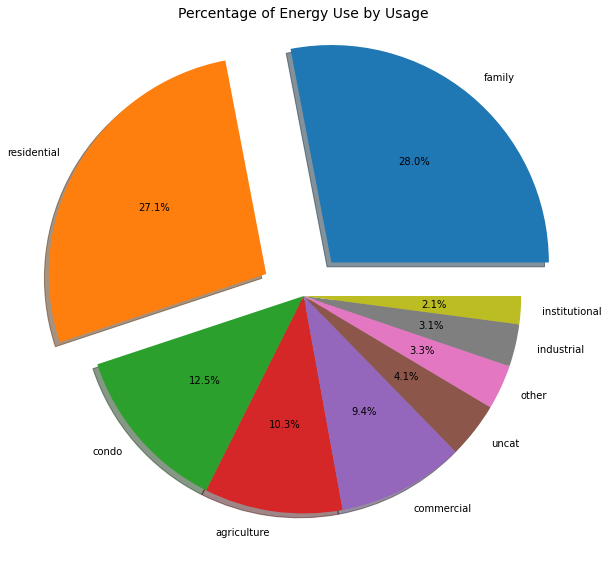

In [55]:
pie_chart =df_energy_consumtions["new_usetype"].value_counts()
myexplode = [0.2,0.2,0,0,0,0,0,0,0]
plt.figure(figsize=(20,10))
plt.title("Percentage of Energy Use by Usage", fontdict={"fontsize":14})
plt.pie(pie_chart.values, labels=pie_chart.index, autopct='%1.1f%%',  shadow=True, explode=myexplode)
plt.show()

In [56]:
df_energy_consumtions[["geo","id"]]=df_energy_consumtions["geo_id"].str.split('_', expand=True)
df_energy_consumtions.head()

C:\Users\AutoMedia\anaconda3\lib\site-packages\pandas\core\frame.py:3641: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,geo_id,sqft,usage,usage_med,usage_med_sqft,usetype,year,pct_elec,pct_ng,name,pop,usage_percap,new_usetype,cat_sqft,geo,id
1,cities_1,4820002.0,307943899305.5130,552251718.742479,46351.2600,commercial,2016,0.729374077813779,0.27062592218622,agoura hills,NaN,NaN,commercial,sqft > 50000,cities,1
2,cities_1,8916603.0,371532651324.6650,75308184.502491,34141.0256,condo,2016,0.401411831210031,0.598588168789969,agoura hills,NaN,NaN,condo,sqft > 50000,cities,1
5,cities_1,742420.0,13880934410.2757,551195246.006691,27645.8101,multi_family,2016,0.494247031872507,0.505752968127493,agoura hills,NaN,NaN,family,sqft > 50000,cities,1
9,cities_1,14582828.0,607423395220.2180,77423013.203888,34664.6960,res_total,2016,0.39367841860114,0.606321581398859,agoura hills,20236.0,30016969.5207,residential,sqft > 50000,cities,1
10,cities_1,4871778.0,185856698385.1830,81616936.012045,36044.4204,single_family,2016,0.404338301428263,0.595661698571739,agoura hills,NaN,NaN,family,sqft > 50000,cities,1


In [57]:
df_energy_consumtions_cities = df_energy_consumtions[df_energy_consumtions["geo"]=="cities"]
df_energy_consumtions_cities.head()

,geo_id,sqft,usage,usage_med,usage_med_sqft,usetype,year,pct_elec,pct_ng,name,pop,usage_percap,new_usetype,cat_sqft,geo,id
1,cities_1,4820002.0,307943899305.5130,552251718.742479,46351.2600,commercial,2016,0.729374077813779,0.27062592218622,agoura hills,NaN,NaN,commercial,sqft > 50000,cities,1
2,cities_1,8916603.0,371532651324.6650,75308184.502491,34141.0256,condo,2016,0.401411831210031,0.598588168789969,agoura hills,NaN,NaN,condo,sqft > 50000,cities,1
5,cities_1,742420.0,13880934410.2757,551195246.006691,27645.8101,multi_family,2016,0.494247031872507,0.505752968127493,agoura hills,NaN,NaN,family,sqft > 50000,cities,1
9,cities_1,14582828.0,607423395220.2180,77423013.203888,34664.6960,res_total,2016,0.39367841860114,0.606321581398859,agoura hills,20236.0,30016969.5207,residential,sqft > 50000,cities,1
10,cities_1,4871778.0,185856698385.1830,81616936.012045,36044.4204,single_family,2016,0.404338301428263,0.595661698571739,agoura hills,NaN,NaN,family,sqft > 50000,cities,1


In [82]:
fig = px.sunburst(df_energy_consumtions_cities, path=["geo","name", "new_usetype"], values="pct_elec", 
                  title="Distribution of Energy Use in each City based on the Buildings Used")
fig.show()

In [59]:
# Top 10 residential with the biggest pct elec
top_10_residential = df_energy_consumtions_cities[df_energy_consumtions_cities["new_usetype"]=="residential"]
top_10_residential[["pct_elec","pct_ng"]] = round(top_10_residential[["pct_elec","pct_ng"]].apply(pd.to_numeric),2)
top_10_residential = top_10_residential.sort_values(by="pct_elec", ascending=False)[:10]

top_10_residential

C:\Users\AutoMedia\anaconda3\lib\site-packages\pandas\core\frame.py:3641: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,geo_id,sqft,usage,usage_med,usage_med_sqft,usetype,year,pct_elec,pct_ng,name,pop,usage_percap,new_usetype,cat_sqft,geo,id
525,cities_138,9688362.0,191442852437.4840,41157252.377246,19403.8597,res_total,2016,0.98,0.02,canyon lake,11900.0,16087634.6586,residential,sqft > 50000,cities,138
1399,cities_203,11702533.0,392625485282.6360,24640780.8027095,20668.3371,residential_other,2016,0.76,0.24,san bernardino unincorporated area,NaN,NaN,residential,sqft > 50000,cities,203
43,cities_101,50347.0,12235369125.4474,59014631.7380675,32983.4834,residential_other,2016,0.75,0.25,fillmore,NaN,NaN,residential,sqft > 50000,cities,101
55,cities_102,222772.0,5868299399.7785,26623244.57031,22432.5991,residential_other,2016,0.70,0.30,moorpark,NaN,NaN,residential,sqft > 50000,cities,102
2228,cities_79,0.0,42086808483.1791,NaN,NaN,residential_uncat,2016,0.70,0.30,westlake village,NaN,NaN,residential,sqft < 10000,cities,79
501,cities_136,4805163.0,242270006167.5770,52147110.755979,39140.4635,res_total,2016,0.62,0.38,blythe,20101.0,12052634.5041,residential,sqft > 50000,cities,136
499,cities_136,452512.0,20849446698.7999,9759072.730146,4568.0053,residential_other,2016,0.60,0.40,blythe,NaN,NaN,residential,sqft > 50000,cities,136
835,cities_161,85936.0,72562290260.2654,33575541.916278,NaN,residential_other,2016,0.60,0.40,eastvale,NaN,NaN,residential,sqft > 50000,cities,161
355,cities_125,2067864.0,161836108147.1510,42530342.910431,NaN,residential_other,2016,0.59,0.41,rancho cucamonga,NaN,NaN,residential,sqft > 50000,cities,125
585,cities_142,12342451.0,546675220953.2820,52581529.846447,35135.1262,res_total,2016,0.58,0.42,desert hot springs,27678.0,19751254.4603,residential,sqft > 50000,cities,142


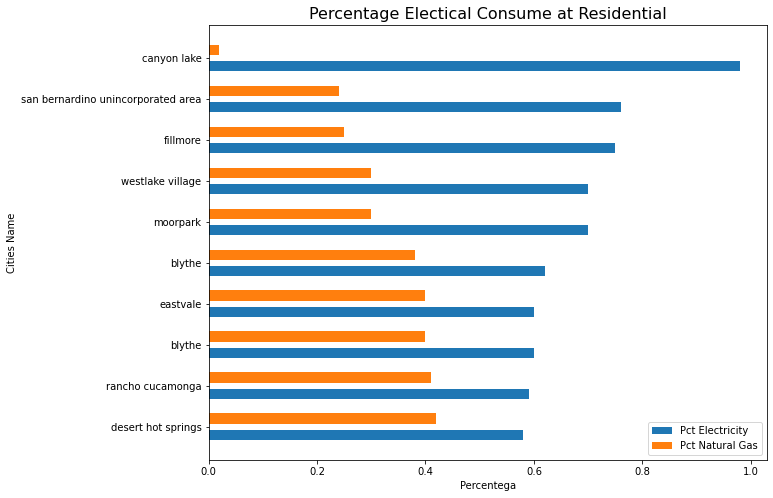

In [60]:
# top_10_residential = round(top_10_residential["pct_elec"],2)
top_10_residential = top_10_residential.sort_values(by="pct_elec", ascending=True)
plt.figure(figsize=(10,8))
y_axis = np.arange(len(top_10_residential.name))

# Multiple Bar
plt.barh(y=y_axis -0.2, width=top_10_residential.pct_elec, label="Pct Electricity", height=0.25)
plt.barh(y=y_axis +0.2, width=top_10_residential.pct_ng, label="Pct Natural Gas", height=0.25)

plt.yticks(y_axis, top_10_residential.name)
plt.title("Percentage Electical Consume at Residential", fontdict={"fontsize":16})
plt.ylabel("Cities Name")
plt.xlabel("Percentega")
plt.legend()


plt.show()

In [61]:
df_test=None

def top_data(df_name,df_data, df_column="new_usetype", value="residential", col_value="pct_elec", number=10):
    """
    Retrun new dataframe after sort some value, with the biggest target
    \n
    df_name : New Dataframe, after sort value
    df_data : Existing Dataframe
    df_column : Which target that you want to look like, 'residential'/'cities/family'
    value : '{family, residential}, as a default for residential'
    col_value : Default pct_elec, as a target for sort value
    number : Target number for top data
    """
    df_name=df_data[df_data[df_column]==value]
    df_name=df_name.sort_values(by=col_value, ascending=False)[:number]
    df_name = df_name.sort_values(by=col_value, ascending=False)[:number]
    return df_name

In [62]:
df_test = top_data(df_name=df_test,df_data=df_energy_consumtions_cities, value="family")
df_test

,geo_id,sqft,usage,usage_med,usage_med_sqft,usetype,year,pct_elec,pct_ng,name,pop,usage_percap,new_usetype,cat_sqft,geo,id
1049,cities_178,6441342.0,22534895702.5044,289387144.036363,3429.1391,multi_family,2016,1,0,laguna woods,NaN,NaN,family,sqft > 50000,cities,178
497,cities_136,229375.0,30603407491.6602,55902938.085951,55050.4317,multi_family,2016,0.716741339746895,0.283258660253105,blythe,NaN,NaN,family,sqft > 50000,cities,136
749,cities_155,150108.0,19531779609.2495,112389121.107754,85468.2916,multi_family,2016,0.66821237883277,0.33178762116723,rancho mirage,NaN,NaN,family,sqft > 50000,cities,155
502,cities_136,4077854.0,159050819640.4080,53779329.3699685,39882.6460,single_family,2016,0.666102821651824,0.333897178348178,blythe,NaN,NaN,family,sqft > 50000,cities,136
725,cities_153,679417.0,180026114083.4590,118303564.781343,141845.7547,multi_family,2016,0.658244711496771,0.341755288503228,palm springs,NaN,NaN,family,sqft > 50000,cities,153
713,cities_152,513602.0,173788215252.0460,138615095.151026,112219.9726,multi_family,2016,0.64003909372667,0.359960906273329,palm desert,NaN,NaN,family,sqft > 50000,cities,152
1193,cities_189,6505625.0,90140136155.3583,98614075.213028,28707.3408,multi_family,2016,0.637980262446639,0.36201973755336,seal beach,NaN,NaN,family,sqft > 50000,cities,189
581,cities_142,1193847.0,103268104771.1500,93056066.901823,50876.1646,multi_family,2016,0.613330118110064,0.386669881889936,desert hot springs,NaN,NaN,family,sqft > 50000,cities,142
406,cities_129,6147293.0,191865506629.5410,38593027.9400465,30431.7229,single_family,2016,0.601363010348263,0.398636989651736,twentynine palms,NaN,NaN,family,sqft > 50000,cities,129
586,cities_142,10872440.0,378625806569.4260,50960205.0615785,34141.9526,single_family,2016,0.599405185128749,0.400594814871252,desert hot springs,NaN,NaN,family,sqft > 50000,cities,142


In [63]:
def fig_bar_top(df_name, value_sorted="pct_ng", y_target="name",value_1="pct_ng", value_2="pct_elec", xlabel="", ylabel="", title=""):
    """
    Create horizontal bar, and do sort value to create bar horizontal from the biggest value to lowest value. Can add title, xlabel,
    and ylabel.
    
    df_name = Dataframe
    value_sorted = columns that want to be sort, as default used column pct_ng
    y_target = target data
    value_1 = default pct_ng
    value_2 = defalut pct_elec
    """
    df_name = df_name.sort_values(by=value_sorted, ascending=True)
    plt.figure(figsize=(10,8))
    y_axis = np.arange(len(top_10_residential[y_target]))

    # Multiple Bar
    plt.barh(y=y_axis -0.2, width=top_10_residential[value_1], label="Pct Electricity", height=0.25)
    plt.barh(y=y_axis +0.2, width=top_10_residential[value_2], label="Pct Natural Gas", height=0.25)

    plt.yticks(y_axis, top_10_residential[y_target])
    plt.title(title, fontdict={"fontsize":16})
    plt.ylabel(ylabel)
    plt.xlabel(xlabel)
    plt.legend()


    plt.show()

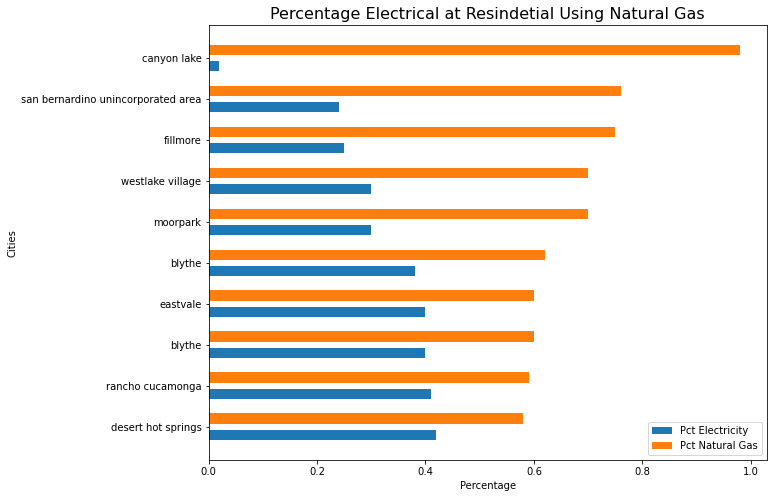

In [64]:
fig_bar_top(df_test, xlabel="Percentage", ylabel="Cities", title="Percentage Electrical at Resindetial Using Natural Gas")

In [65]:
def another_pie_chart(chart_name, df, target, title):
    
    chart_name= df[target].value_counts()
    #myexplode = [0.2,0.2,0.1,0.1,0.1,0.1]
    plt.figure(figsize=(20,10))
    plt.title(title, fontdict={"fontsize":14})
    plt.pie(chart_name.values, labels=chart_name.index, autopct='%1.1f%%')
    plt.legend(chart_name.index, loc="best")
    plt.show()

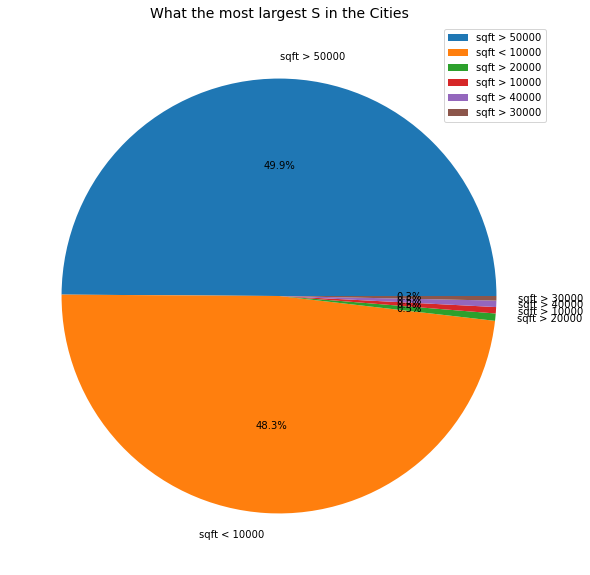

In [66]:
pie_chart = another_pie_chart(pie_chart, df_energy_consumtions_cities, target="cat_sqft", 
                              title="What the most largest S in the Cities")

In [67]:
read_data[7].head()

,geo_id,sqft,usage,usage_med,usage_med_sqft,usetype,year,name,solar_potential,pop,usage_percap
0,cities_1,1253.0,masked,masked,masked,agriculture,2016,agoura hills,NaN,NaN,masked
1,cities_1,4802115.0,65825608.0000,121901,9.7676,commercial,2016,agoura hills,NaN,NaN,NaN
2,cities_1,8906397.0,43707916.6000,9136,3.9839,condo,2016,agoura hills,NaN,NaN,NaN
3,cities_1,734698.0,masked,masked,masked,industrial,2016,agoura hills,NaN,NaN,masked
4,cities_1,100192.0,masked,masked,masked,institutional,2016,agoura hills,NaN,NaN,masked


# Concat All Data Become One

In [68]:
results = pd.concat(read_data[6:22])
results.head()

,geo_id,sqft,usage,usage_med,usage_med_sqft,usetype,year,pct_elec,pct_ng,name,pop,usage_percap,solar_potential,income_quintile,income_range,sqft_id,vintage_id,building vintage
0,cities_1,1253.0,masked,masked,masked,agriculture,2016.0,masked,masked,agoura hills,NaN,masked,NaN,NaN,NaN,NaN,NaN,NaN
1,cities_1,4820002.0,20221.0949,36.800686,0.0030,commercial,2016.0,0.781270550460555,0.218729449539445,agoura hills,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,cities_1,8916603.0,22293.3724,4.52721,0.0021,condo,2016.0,0.470555704819359,0.52944429518064,agoura hills,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,cities_1,735816.0,masked,masked,masked,industrial,2016.0,masked,masked,agoura hills,NaN,masked,NaN,NaN,NaN,NaN,NaN,NaN
4,cities_1,100192.0,masked,masked,masked,institutional,2016.0,masked,masked,agoura hills,NaN,masked,NaN,NaN,NaN,NaN,NaN,NaN


In [69]:
results.year.value_counts()

2016.0    194805
Name: year, dtype: int64

In [70]:
results.isna().sum()

geo_id              4     
sqft                92729 
usage               79533 
usage_med           88328 
usage_med_sqft      89286 
usetype             4     
year                4     
pct_elec            127247
pct_ng              127247
name                4     
pop                 185011
usage_percap        178296
solar_potential     194809
income_quintile     182784
income_range        182784
sqft_id             167873
vintage_id          56277 
building vintage    194805
dtype: int64

In [71]:
read_data[13].head()

,geo_id,sqft,sqft_id,usage,usage_med,usage_med_sqft,usetype,year,pct_elec,pct_ng,name
0,cities_1,NaN,1,NaN,NaN,NaN,multi_family,2016,NaN,NaN,agoura hills
1,cities_1,29932.0,2,masked,masked,masked,multi_family,2016,masked,masked,agoura hills
2,cities_1,25601.0,3,masked,masked,masked,multi_family,2016,masked,masked,agoura hills
3,cities_1,46427.0,4,masked,masked,masked,multi_family,2016,masked,masked,agoura hills
4,cities_1,NaN,5,NaN,NaN,NaN,multi_family,2016,NaN,NaN,agoura hills


In [80]:
df_solar_potensial = results.sort_values("solar_potential", ascending=True)
df_solar_potensial.head()

,geo_id,sqft,usage,usage_med,usage_med_sqft,usetype,year,pct_elec,pct_ng,name,pop,usage_percap,solar_potential,income_quintile,income_range,sqft_id,vintage_id,building vintage
0,cities_1,1253.0,masked,masked,masked,agriculture,2016.0,masked,masked,agoura hills,NaN,masked,NaN,NaN,NaN,NaN,NaN,NaN
1,cities_1,4820002.0,20221.0949,36.800686,0.0030,commercial,2016.0,0.781270550460555,0.218729449539445,agoura hills,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,cities_1,8916603.0,22293.3724,4.52721,0.0021,condo,2016.0,0.470555704819359,0.52944429518064,agoura hills,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,cities_1,735816.0,masked,masked,masked,industrial,2016.0,masked,masked,agoura hills,NaN,masked,NaN,NaN,NaN,NaN,NaN,NaN
4,cities_1,100192.0,masked,masked,masked,institutional,2016.0,masked,masked,agoura hills,NaN,masked,NaN,NaN,NaN,NaN,NaN,NaN


In [81]:
read_data[7].head()

,geo_id,sqft,usage,usage_med,usage_med_sqft,usetype,year,name,solar_potential,pop,usage_percap
0,cities_1,1253.0,masked,masked,masked,agriculture,2016,agoura hills,NaN,NaN,masked
1,cities_1,4802115.0,65825608.0000,121901,9.7676,commercial,2016,agoura hills,NaN,NaN,NaN
2,cities_1,8906397.0,43707916.6000,9136,3.9839,condo,2016,agoura hills,NaN,NaN,NaN
3,cities_1,734698.0,masked,masked,masked,industrial,2016,agoura hills,NaN,NaN,masked
4,cities_1,100192.0,masked,masked,masked,institutional,2016,agoura hills,NaN,NaN,masked


In [ ]:
read_data

### Trying To Create Box Plot for Every Columns

In [73]:
# fig, axs = plt.subplots(1, len(df_geos.columns[2:]), figsize=(20,10))


# axs[0].violinplot(df_geos['pop'],
#                   showmeans=False,
#                   showmedians=True)
# axs[0].set_title('Violin plot')

# axs[1].boxplot(df_geos['pop_sqmi'])
# axs[1].set_title('Box plot')

# for i, ax in enumerate(axs.flat):
#     ax.yaxis.grid(True)
    
# plt.show()

In [74]:
# box_fig = px.box(df_geos, y=["med_income","pop_sqmi","pct_own","pct_rent", "pop","enviroscreen_tracts", "count", "solar_pot"])
# box_fig.show()

In [75]:
# df_geos.plot(kind='box')

In [76]:
# df_geos.columns[2:]

In [77]:
# df_geos = df_geos.fillna(method='ffill')

In [78]:
# red_circle = dict(markerfacecolor='red', marker='o', markeredgecolor='white')
# # plt.boxplot(df_geos["med_income"], flierprops=red_circle)
# fig, axs = plt.subplots(1, len(df_geos.columns[2:4]), figsize=(20,10))

# for i, ax in enumerate(axs.flat):
#     ax.box(df_geos.iloc[:,i], flierprops=red_circle)
#     ax.set_title(df_geos.columns[i], fontsize=20, fontdict={'fontweight':"bold"})
#     ax.tick_params(axis="y", labelsize=14)
    
# plt.tight_layout()

In [79]:
# sns.set_theme(style="whitegrid")
# ax = sns.boxplot(x=df_geos.pop)